In [3]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -r requirements.txt  # install
%pip install -q roboflow

import torch
import os
from IPython.display import Image , clear_output


print(f"setup using torch {torch.__version__}({torch.cuda.get_device_properties(0).name if torch.cuda.is_available else 'cpu' })")


[WinError 2] Le fichier spécifié est introuvable: 'yolov5'
C:\Users\HP\AnalyseVideo\projetAnalyseVideo


fatal: Too many arguments.

usage: git clone [<options>] [--] <repo> [<dir>]

    -v, --verbose         be more verbose
    -q, --quiet           be more quiet
    --progress            force progress reporting
    --reject-shallow      don't clone shallow repository
    -n, --no-checkout     don't create a checkout
    --bare                create a bare repository
    --mirror              create a mirror repository (implies bare)
    -l, --local           to clone from a local repository
    --no-hardlinks        don't use local hardlinks, always copy
    -s, --shared          setup as shared repository
    --recurse-submodules[=<pathspec>]
                          initialize submodules in the clone
    --recursive ...       alias of --recurse-submodules
    -j, --jobs <n>        number of submodules cloned in parallel
    --template <template-directory>
                          directory from which templates will be used
    --reference <repo>    reference repository
    --refere

Note: you may need to restart the kernel to use updated packages.


ERROR: Invalid requirement: '#'


Note: you may need to restart the kernel to use updated packages.


AssertionError: Torch not compiled with CUDA enabled

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf=Roboflow(model_format="yolov5" , notebook="ultralytics" )



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
os.environ["DATASET_DIRECTORY"]="/content/dataset"

In [ ]:
rf = Roboflow(api_key="jNUvYCA8LKPWXVFzZdex")
project = rf.workspace("videonalyticyolov5").project("detection-player-football")
dataset = project.version(2).download("yolov5")


loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/dataset/Detection-player-football-2 in yolov5pytorch:: 100%|██████████| 3462/3462 [00:01<00:00, 1977.04it/s]


In [ ]:
!python train.py --img 640 --epochs 100 --data {dataset.location}/data.yaml --weights yolov5n.pt --cache # --batch-size 128 



train: weights=yolov5n.pt, cfg=, data=/content/dataset/Detection-player-football-2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-72-g064365d Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamm

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640  --conf 0.1 --source {dataset.location}/valid/images

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/dataset/Detection-player-football-2/valid/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 1764577 parameters, 0 gradients, 4.1 GFLOPs
image 1/66 /content/dataset/Detection-player-football-2/valid/images/08fd33_0_4_png_jpg.rf.41b2fa456f04925a93b89f678643670b.jpg: 640x640 1 ball, 21 players, 2 referees, 8.9ms
image 2/66 /content/dataset/Detection-player-football-2/valid/images/08fd33_0_5_png_jpg.rf.246348e38814aa0867729b9a95ecc

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640  --conf 0.3 --source {dataset.location}/test/images

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/dataset/Detection-player-football-2/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.3, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 1764577 parameters, 0 gradients, 4.1 GFLOPs
image 1/66 /content/dataset/Detection-player-football-2/test/images/08fd33_0_3_png_jpg.rf.a07e2bddac859300278dce0464a70773.jpg: 640x640 21 players, 2 referees, 10.1ms
image 2/66 /content/dataset/Detection-player-football-2/test/images/08fd33_3_10_png_jpg.rf.1389331c644f05eeaaacf5f453528e75.jpg: 

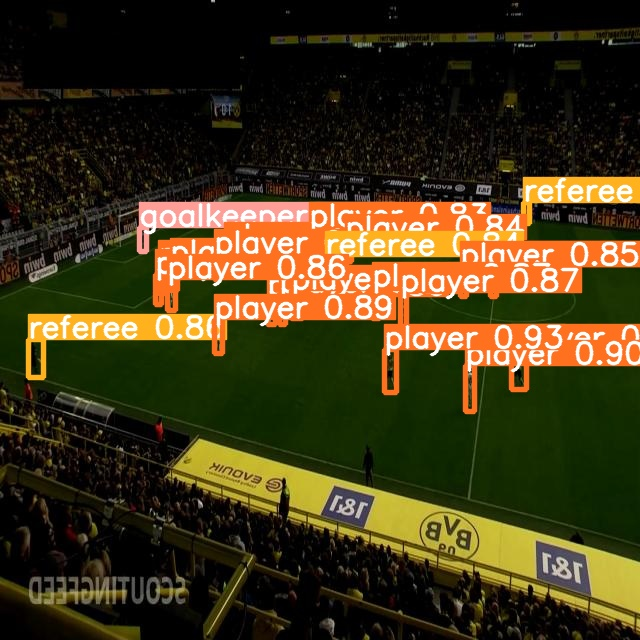

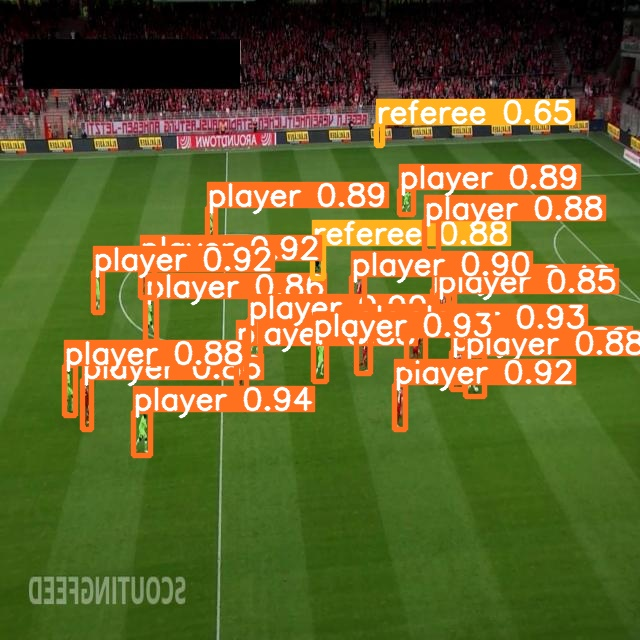

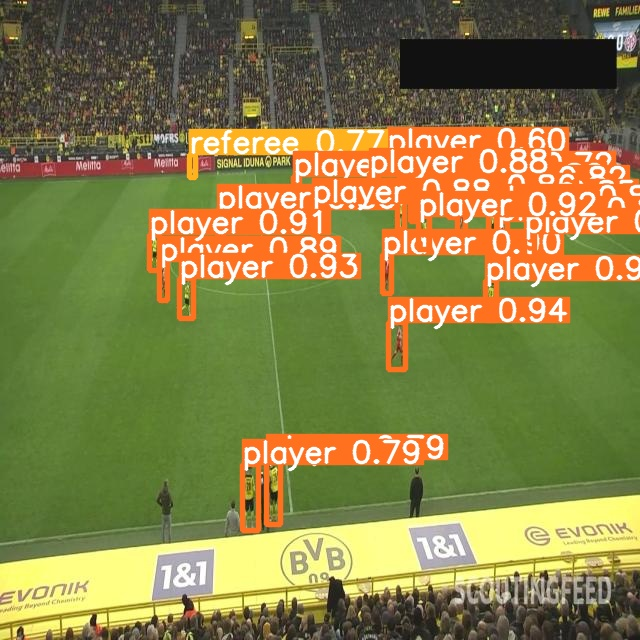

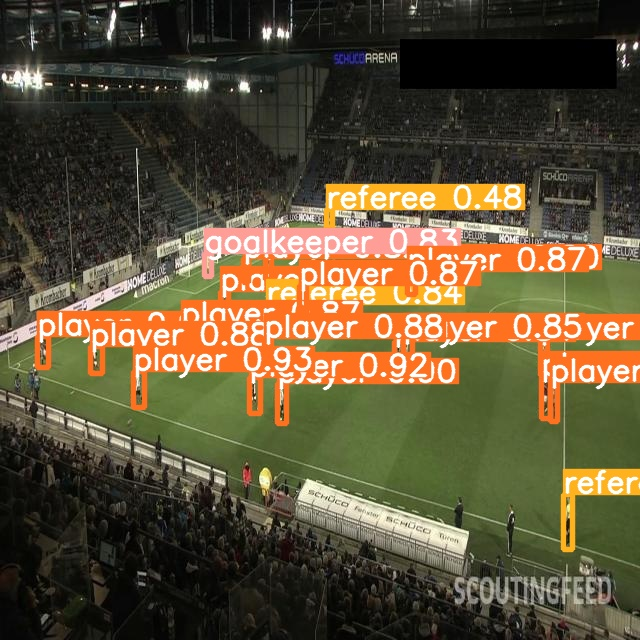

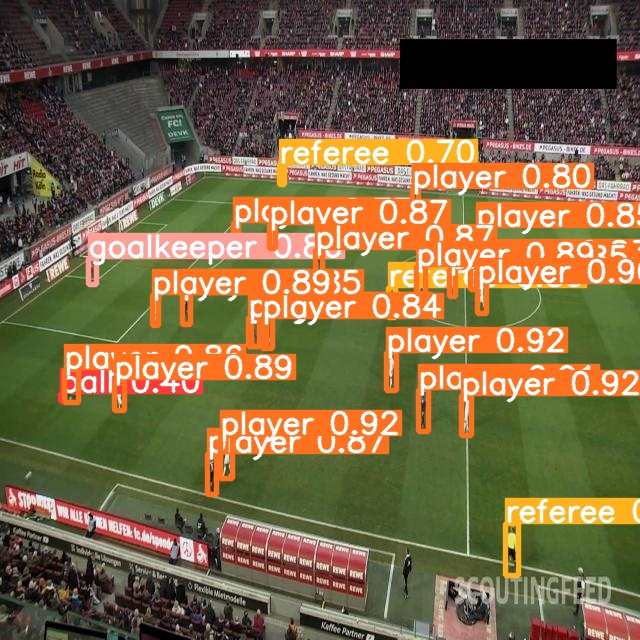

...

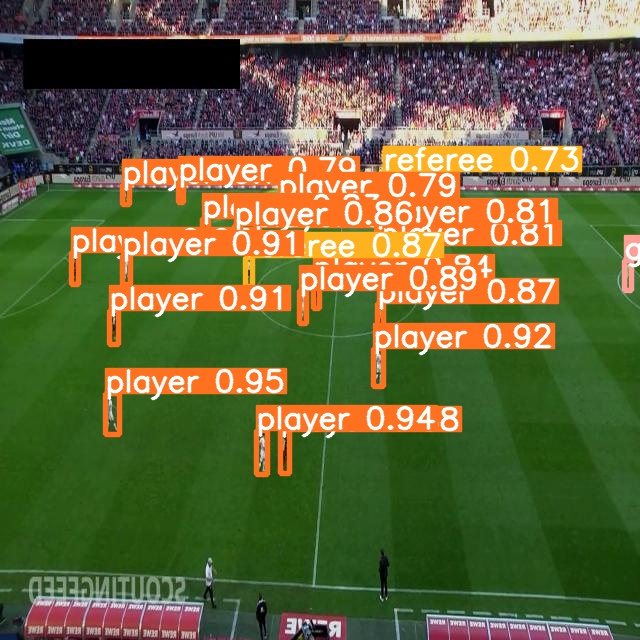

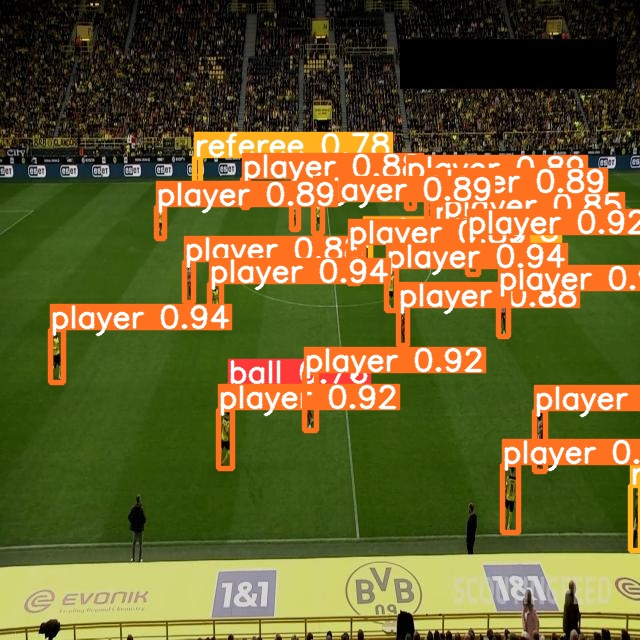

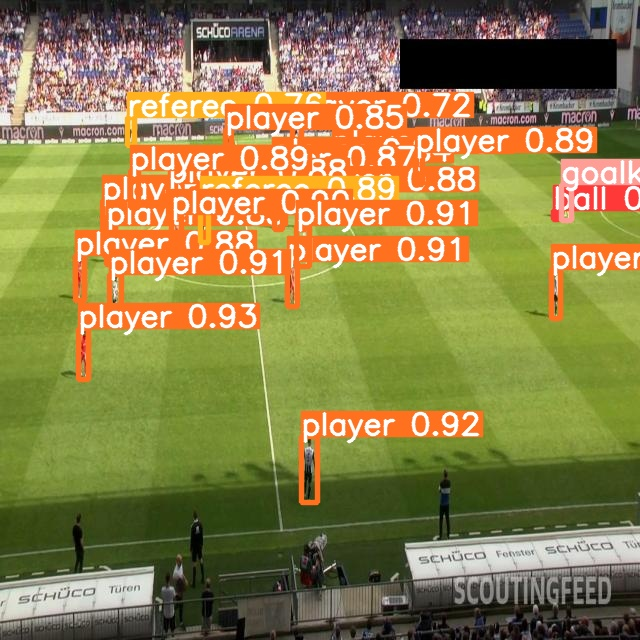

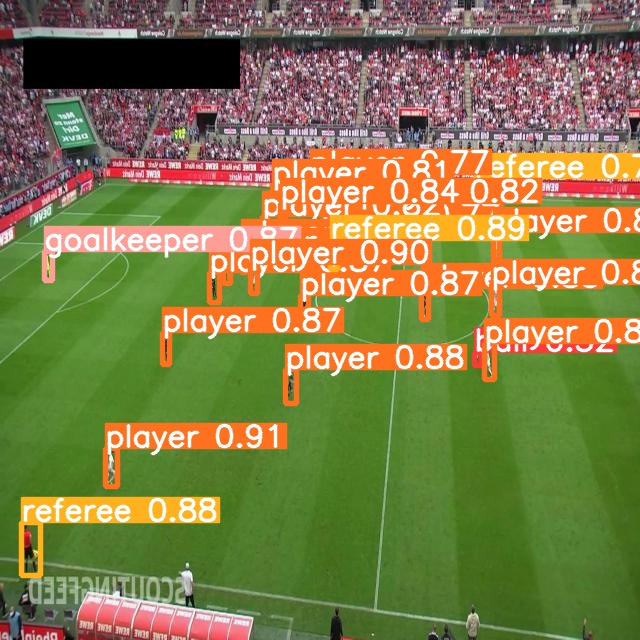

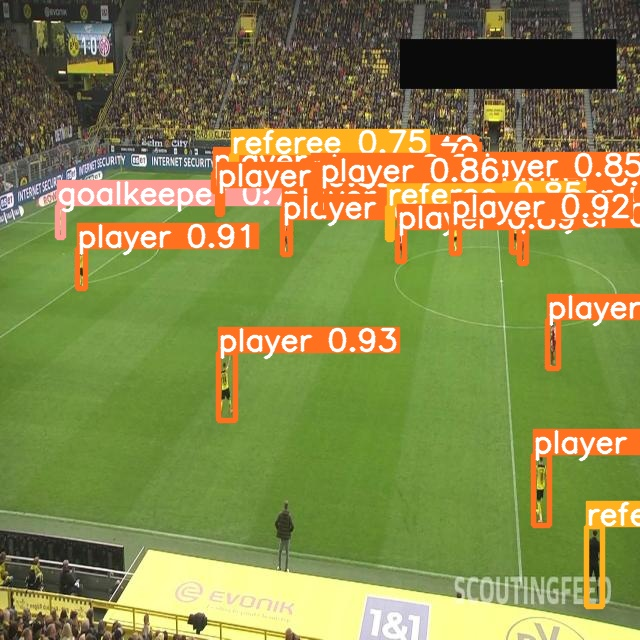

In [ ]:
import glob 
from IPython.display import Image , display 

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'):
  display(Image(filename=imageName))
  print('\n')

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640  --conf 0.3 --source /content/videoMaroc.mp4

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
video 1/1 (3135/8132) /content/videoMaroc.mp4: 384x640 (no detections), 8.3ms
video 1/1 (3136/8132) /content/videoMaroc.mp4: 384x640 (no detections), 9.0ms
video 1/1 (3137/8132) /content/videoMaroc.mp4: 384x640 (no detections), 10.9ms
video 1/1 (3138/8132) /content/videoMaroc.mp4: 384x640 (no detections), 9.2ms
video 1/1 (3139/8132) /content/videoMaroc.mp4: 384x640 (no detections), 8.8ms
video 1/1 (3140/8132) /content/videoMaroc.mp4: 384x640 (no detections), 8.5ms
video 1/1 (3141/8132) /content/videoMaroc.mp4: 384x640 (no detections), 8.5ms
video 1/1 (3142/8132) /content/videoMaroc.mp4: 384x640 1 player, 7.6ms
video 1/1 (3143/8132) /content/videoMaroc.mp4: 384x640 1 player, 10.2ms
video 1/1 (3144/8132) /content/videoMaroc.mp4: 384x640 (no detections), 8.6ms
video 1/1 (3145/8132) /content/videoMaroc.mp4: 384x640 1 ball, 1 goalkeeper, 15 players, 3 referees, 8.1ms
video 1/1 (3146/8132) /content/videoMaroc.mp4: 